# Introduction

this notebook wil show how the model can be used for reconstructing the inputs...

In [1]:
import sys, os
sys.path.append('..')

In [2]:
import matplotlib.pyplot as plt
from src.drone_em_dl import *

In [3]:
data = data.Data()
data.load_data('../data/raw/falster_data_Kristian.csv')
data.get_features([11,12,13,22,23,24,25,26,27,28,29,30,31]) #[1,2,3,4,5,6,7,8,9,10,11,12,13,14]  #[1,2,3,4,5,6,7,11,12,13,14,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31]
data.train_test_split(split=0.8)
data.norm_data()

In [4]:
data.df

,Heading,Pitch,Roll,Ip_475Hz,Qd_475Hz,Ip_1525Hz,Qd_1525Hz,Ip_5325Hz,Qd_5325Hz,Ip_18325Hz,Qd_18325Hz,Ip_63025Hz,Qd_63025Hz
0,-22.22,3.38,-7.54,617.1,-128.4,600.2,-244.7,198.4,84.6,281.3,454.5,4328.0,226.2
1,-22.25,3.78,-6.92,573.1,105.1,539.3,-218.9,246.6,12.8,411.8,631.0,4240.2,78.9
2,-22.18,4.20,-6.27,531.8,43.3,498.1,-187.2,236.3,-7.9,307.6,737.4,4168.3,74.6
3,-22.20,4.61,-5.84,512.3,-84.1,435.6,-128.8,146.1,37.0,268.7,627.1,4099.0,147.2
4,-22.05,4.89,-5.91,509.6,-41.0,416.1,-171.6,103.7,110.9,431.6,559.8,4096.2,95.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
56148,-24.28,5.66,-7.08,492.9,-50.3,525.5,-211.2,169.0,118.5,400.0,191.6,4148.4,-317.0
56149,-23.75,3.23,-6.96,511.8,9.6,558.0,-217.4,182.7,15.6,587.2,115.8,4032.2,-237.5
56150,-23.17,0.61,-6.87,525.1,-13.1,546.4,-223.7,214.1,35.7,594.1,322.7,4041.8,-181.0
56151,-22.67,-1.88,-6.85,545.1,-80.7,499.1,-219.4,244.1,72.7,414.4,488.3,4071.9,-191.9


In [5]:
data.train

,Heading,Pitch,Roll,Ip_475Hz,Qd_475Hz,Ip_1525Hz,Qd_1525Hz,Ip_5325Hz,Qd_5325Hz,Ip_18325Hz,Qd_18325Hz,Ip_63025Hz,Qd_63025Hz
46750,-24.48,6.02,-10.16,521.2,-226.2,393.9,-246.4,193.9,46.0,474.5,265.6,4089.2,-330.1
15846,-19.93,5.21,-4.86,501.9,48.5,655.1,-341.5,188.9,197.3,562.3,81.5,4175.7,684.5
43018,-20.59,6.40,-3.96,545.1,-213.9,567.4,-289.1,194.7,1.1,353.6,291.4,4095.0,-482.7
8661,-30.91,5.66,-17.03,577.6,-17.4,652.8,-206.1,395.7,127.8,694.6,865.2,4343.8,850.9
52012,-20.73,8.42,-4.34,468.4,-102.5,619.6,-206.1,27.8,-12.1,485.0,156.1,3974.2,-591.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
36767,-23.97,3.48,-10.68,463.0,-46.4,417.3,-257.3,97.0,51.2,536.7,287.4,3975.8,-373.9
23026,-16.76,2.58,-4.83,625.8,-46.4,560.1,-214.4,267.9,159.4,1223.0,751.2,4274.4,1341.5
13049,-29.27,0.39,-5.58,526.4,-214.4,509.7,-193.7,283.0,97.7,496.5,243.3,4004.1,-494.7
30986,-17.06,9.74,-6.10,501.7,-121.9,518.3,-268.3,200.7,135.2,209.4,813.5,4015.5,88.2


In [6]:
model = tf.keras.models.load_model('../models/AE_falter_06_04_2023_15_1/best_model_AE_falter_06_04_2023_15_1.h5', custom_objects={'lr': get_lr_metric})

2023-04-07 13:07:01.097977: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-04-07 13:07:01.098111: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Metal device set to: Apple M1 Max

systemMemory: 64.00 GB
maxCacheSize: 24.00 GB



In [15]:
results = Reconstruction()
results.load_model(model)
results.get_reconstructions(data.norm_data.norm_train)

In [16]:
results.model.summary()

Model: "AE_falter_06_04_2023_15_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 AE_input (InputLayer)       [(None, 13)]              0         
                                                                 
 encoder_model (Functional)  (None, 15)                288830    
                                                                 
 decoder_model (Functional)  (None, 13)                144293    
                                                                 
Total params: 433,123
Trainable params: 426,523
Non-trainable params: 6,600
_________________________________________________________________


In [17]:
recionstructed_data = data.get_inv(results.reconstructions)
input_data  = data.get_inv(data.norm_data.norm_train)
latent_space = results.latent_space

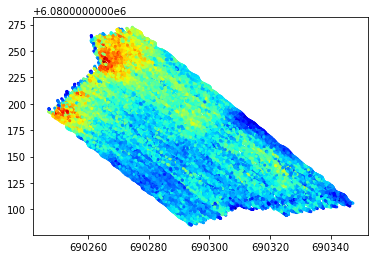

In [23]:
plt.scatter(data.org_train.X,data.org_train.Y,c=input_data[:,-1],cmap='jet',s=4)

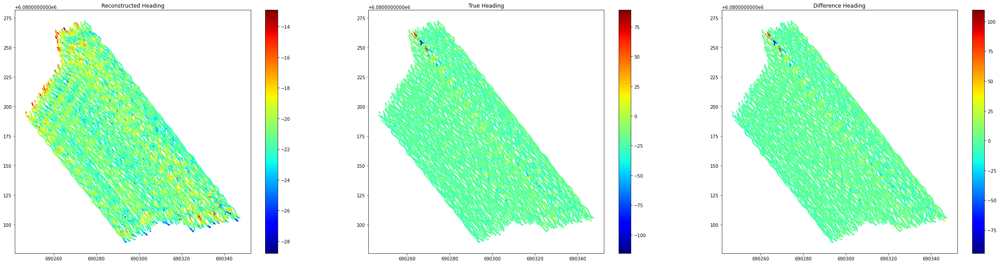

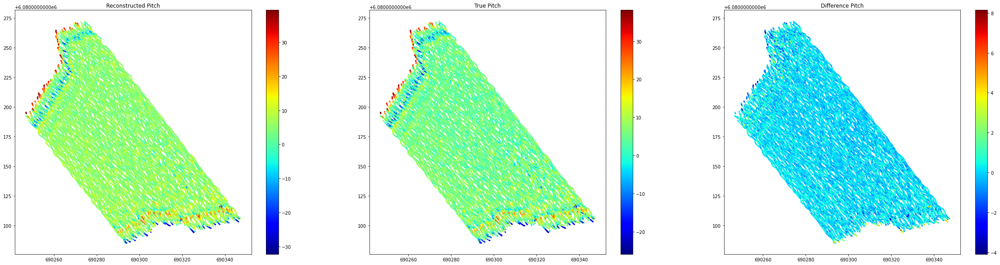

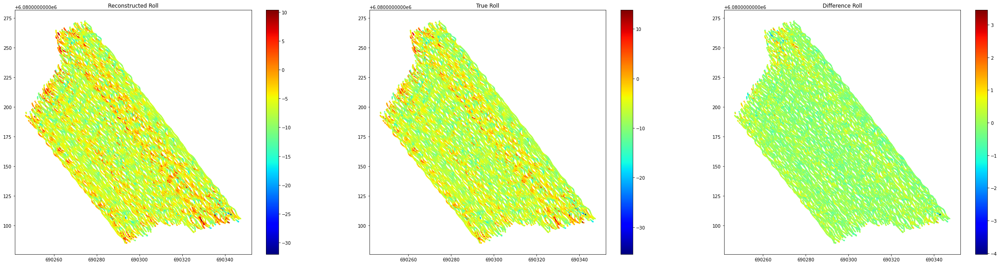

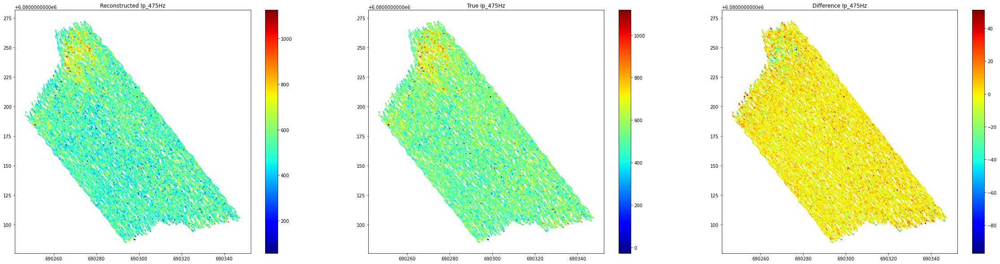

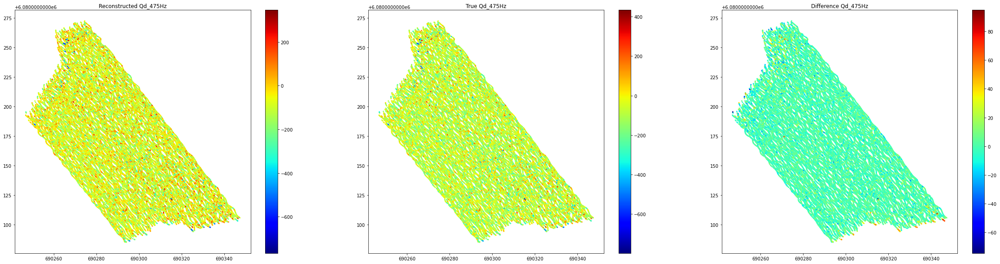

...

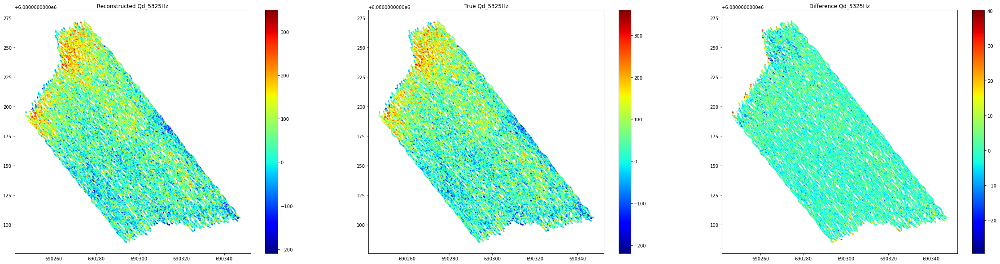

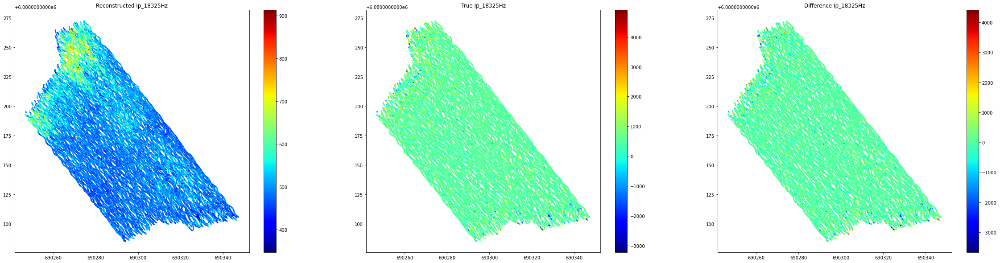

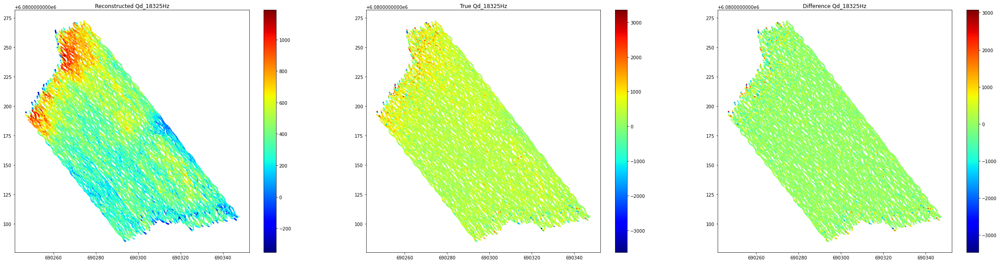

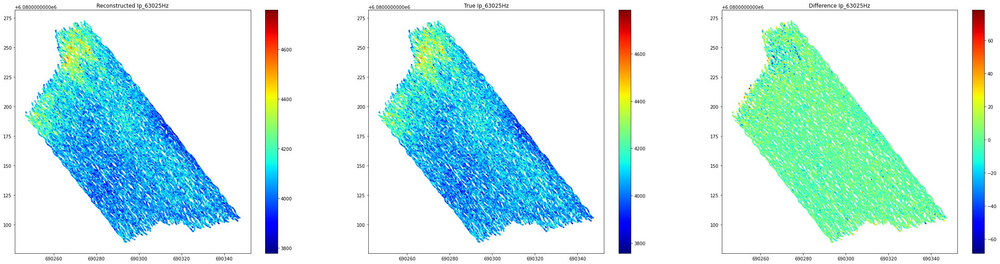

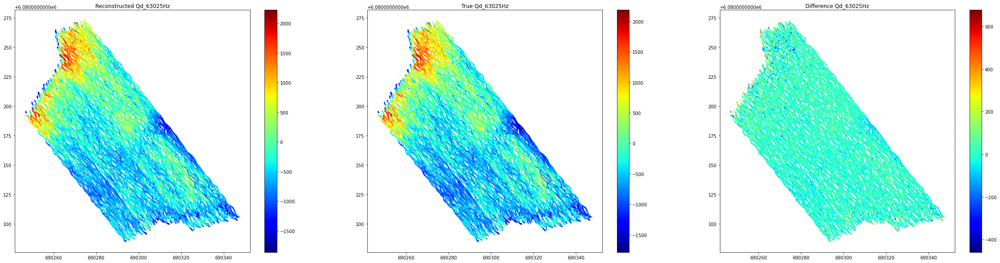

In [19]:
for i in range(13):
    plt.figure(figsize=(40,10))
    plt.subplot(1,3,1)
    plt.title(f'Reconstructed {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,2)
    plt.title(f'True {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=input_data[:,i],cmap='jet',s=4)
    plt.colorbar()

    plt.subplot(1,3,3)
    plt.title(f'Difference {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=input_data[:,i]-recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()
    plt.show()

# Ser bidraget fra en enkelt laten space var

In [20]:
results.get_reconstructions(data.norm_data.norm_train,keep_latent_varible=3)

In [21]:
recionstructed_data = data.get_inv(results.reconstructions)
input_data  = data.get_inv(data.norm_data.norm_train)
latent_space = results.latent_space

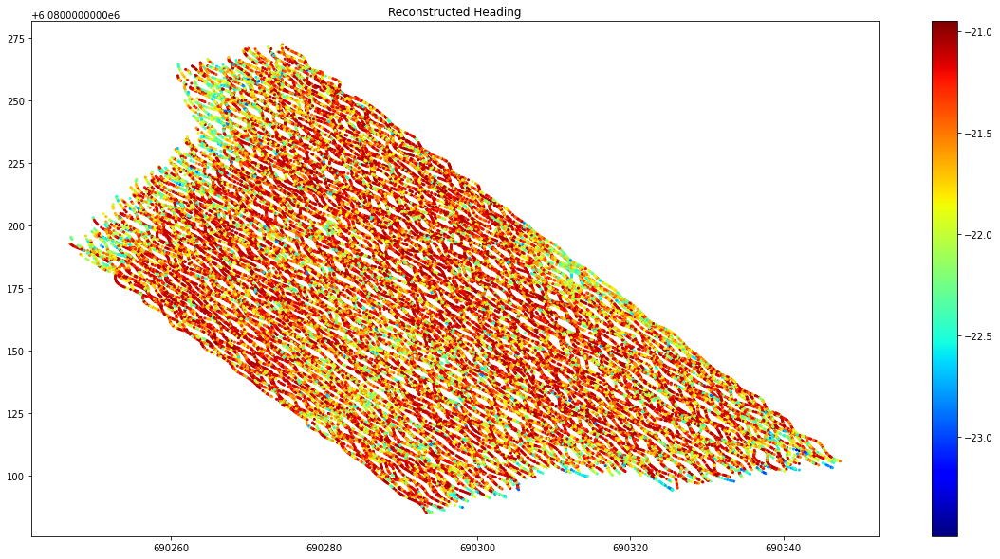

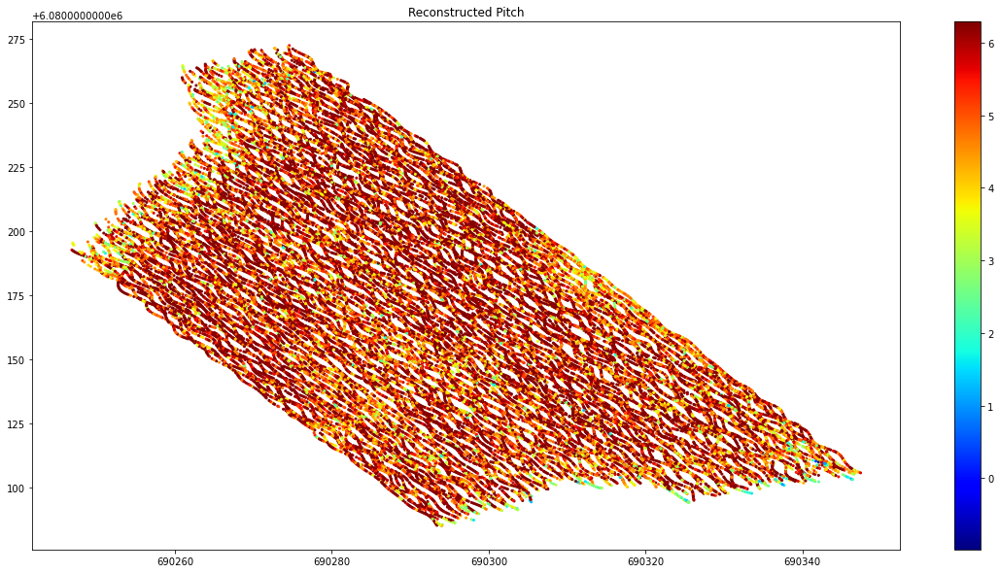

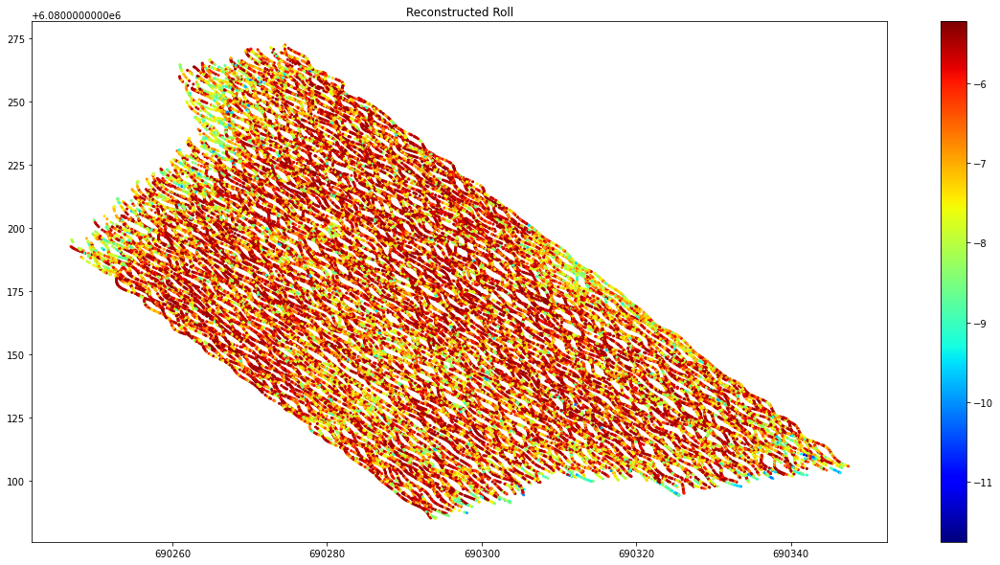

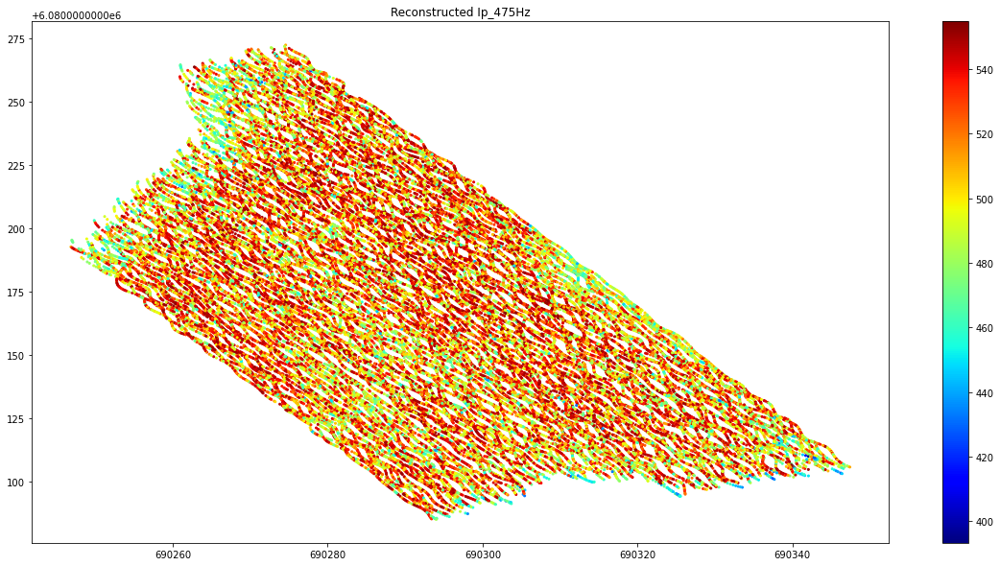

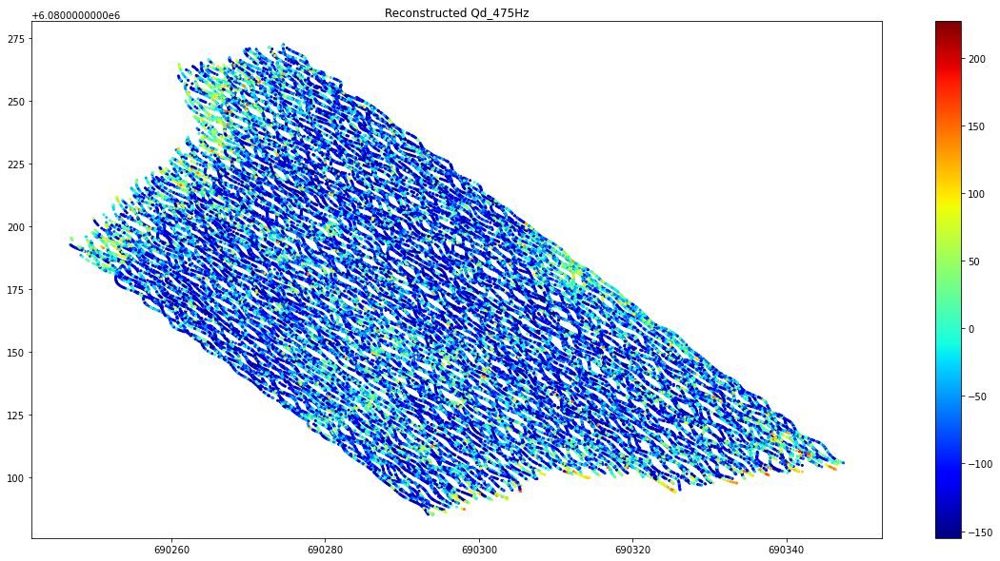

...

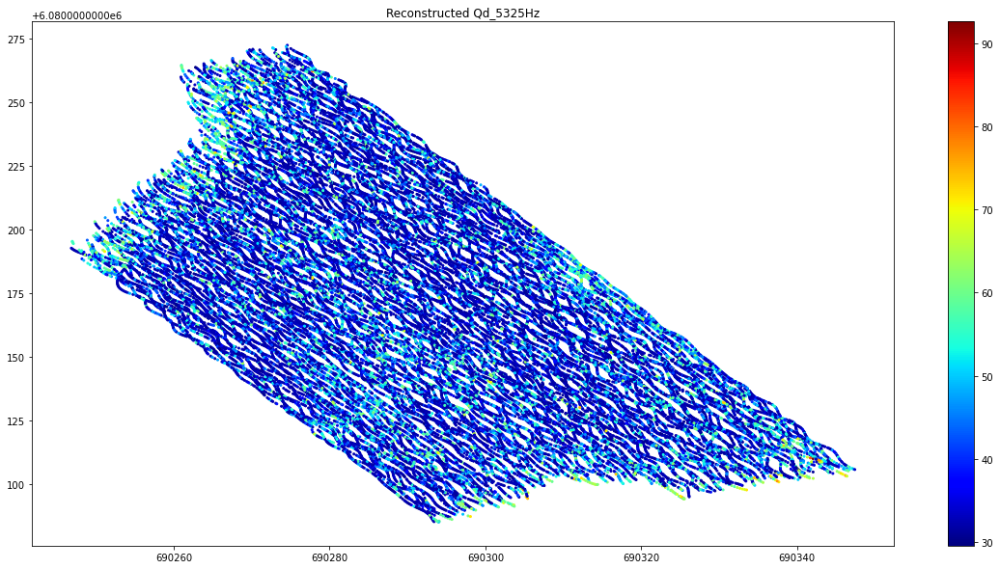

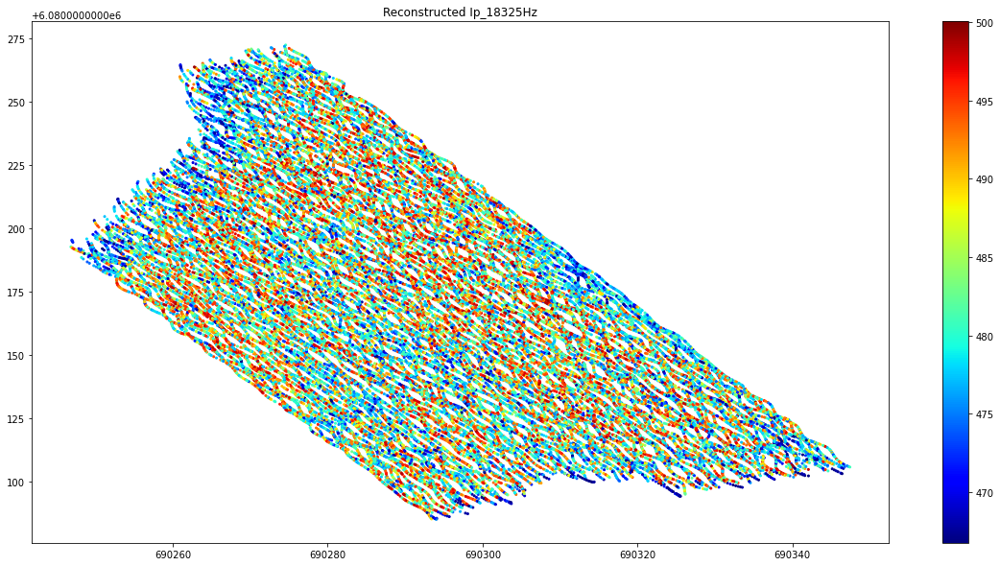

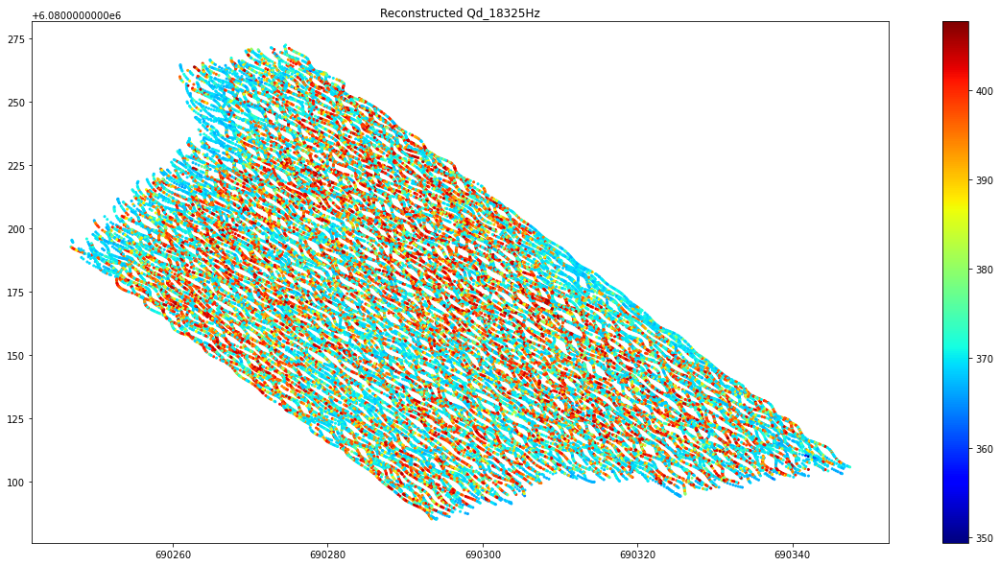

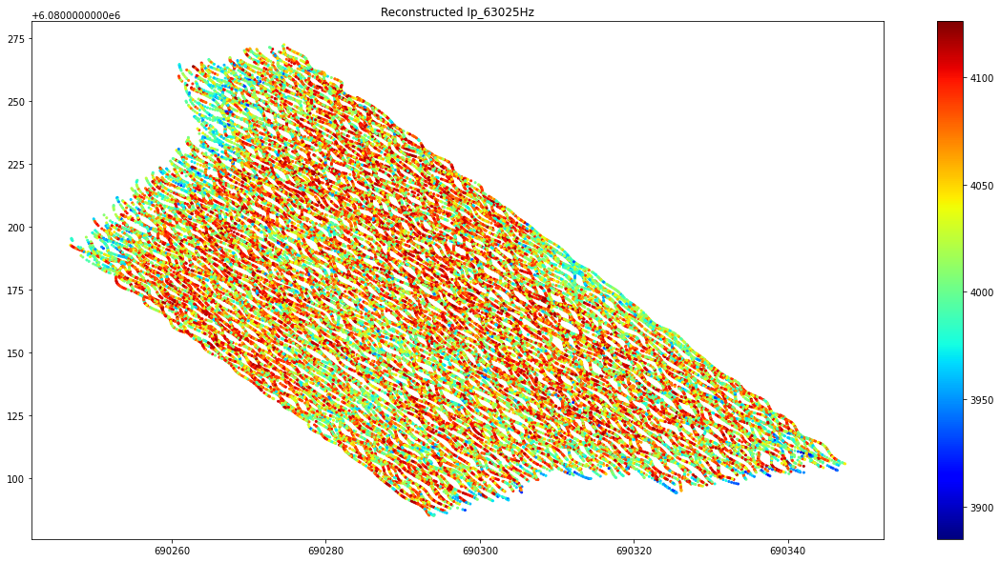

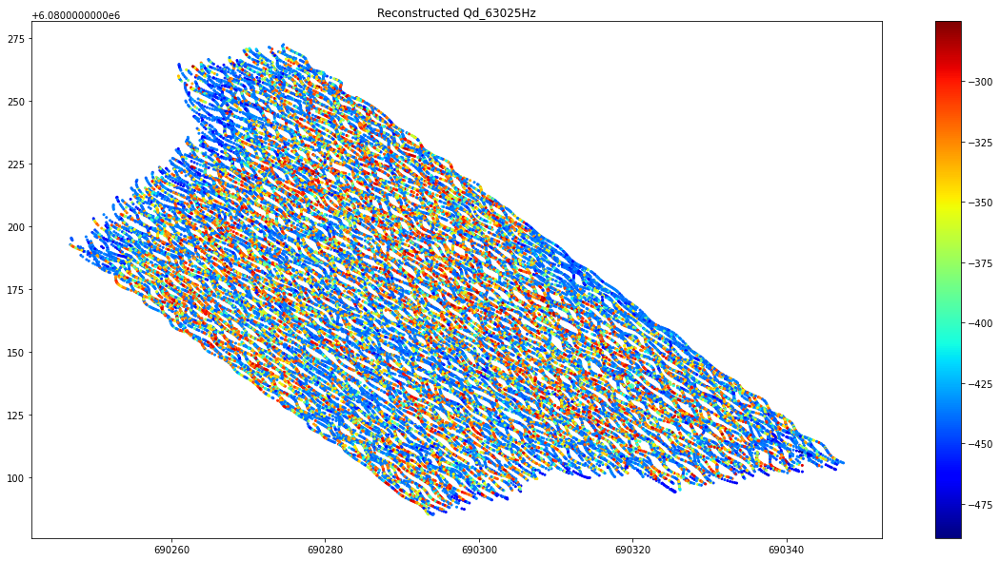

In [22]:
for i in range(13):
    plt.figure(figsize=(20,10))
    plt.title(f'Reconstructed {data.test.columns[i]}')
    cm = plt.scatter(data.org_train.X,data.org_train.Y,c=recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()


In [ ]:
for i in range(13):
    plt.figure(figsize=(20,10))
    plt.title(f'Reconstructed {data.test.columns[i]}')
    cm = plt.scatter(data.org_test.X,data.org_test.Y,c=recionstructed_data[:,i],cmap='jet',s=4)
    plt.colorbar()
